<a href="https://colab.research.google.com/github/aishamohamed/BigDataProject/blob/main/DCGAN_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision import datasets, transforms, utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import torchvision
import torchvision.transforms as T
import torch.optim as optim
import torch.nn.functional as F
from torchvision.datasets import ImageFolder
from torch.utils.data import Subset
import random

random.seed(42)
torch.manual_seed(42)
torch.cuda.manual_seed_all(42)


# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Running on:", device)

Running on: cuda


In [ ]:
# Hyperparams
lr = 0.0002
beta1, beta2= 0.5, 0.999
real_label = 1.0
fake_label = 0.0
d_steps = 1
g_steps = 1
nz = 100
ngf, ndf = 64, 64
image_size = 128
batch_size = 32
n_epochs = 300


In [ ]:
# DataLoader
data_root = "/content/drive/MyDrive/ISIC2017/by_class_128"


transform = T.Compose([
    T.Resize(image_size),
    T.CenterCrop(image_size),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),    # maps pixel → [–1,1]
])

# Build dataset object
full_ds = ImageFolder(data_root, transform=transform)

# get the integer label for "melanoma"
mel_idx = full_ds.class_to_idx['melanoma']

# pick only those indices whose label == mel_idx
mel_inds = [i for i, _ in enumerate(full_ds.targets) if full_ds.targets[i] == mel_idx]

# build a smaller dataset & loader
mel_ds = Subset(full_ds, mel_inds)

dataloader = DataLoader(
    mel_ds,
    batch_size=batch_size,  # how many images per step
    shuffle=True,           # randomize order each epoch
    num_workers=2)          # use 2 subprocesses to load data in parallel

print("Only melanoma—total images:", len(mel_ds))

Only melanoma—total images: 374


In [ ]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # 1×1→4×4
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            # 4→8
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            # 8→16
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # 16→32
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # 32→64
            nn.ConvTranspose2d(ngf, ngf//2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf//2),
            nn.ReLU(True),
            # 64→128
            nn.ConvTranspose2d(ngf//2, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )
    def forward(self, x):
        return self.main(x)

class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.main = nn.Sequential(
            # 128→64
            nn.Conv2d(3, ndf//2, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, True),
            # 64→32
            nn.Conv2d(ndf//2, ndf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf),
            nn.LeakyReLU(0.2, True),
            # 32→16
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, True),
            # 16→8
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, True),
            # 8→4
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, True),
            # 4→1
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )
    def forward(self, x):
        return self.main(x).view(-1)

In [ ]:
# Weight init as in DCGAN paper
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

G = Generator().to(device)
D = Discriminator().to(device)
G.apply(weights_init)
D.apply(weights_init)


Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (12): BatchNorm2d(512, eps=1e-05, mom

In [ ]:
# Loss, Optimizers & fixed noise
criterion = nn.BCELoss()
optimizerD = torch.optim.Adam(D.parameters(), lr=lr, betas=(beta1,beta2))
optimizerG = torch.optim.Adam(G.parameters(), lr=lr, betas=(beta1,beta2))
fixed_noise = torch.randn(64, nz, 1, 1, device=device)


Epoch   1/300   Loss_D: 0.8111   Loss_G: 2.6519


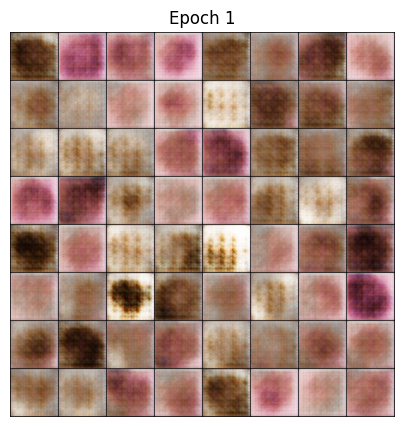

Epoch   2/300   Loss_D: 1.1051   Loss_G: 2.6025
Epoch   3/300   Loss_D: 0.9101   Loss_G: 2.5025
Epoch   4/300   Loss_D: 0.9116   Loss_G: 3.5140
Epoch   5/300   Loss_D: 1.1885   Loss_G: 2.4070


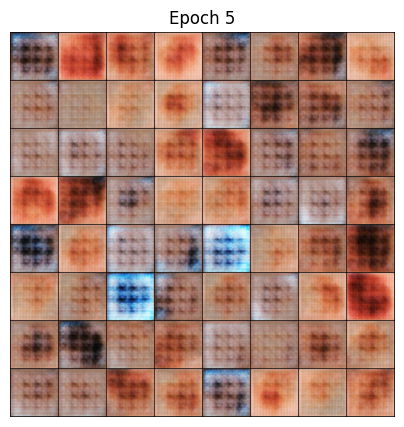

Epoch   6/300   Loss_D: 1.0654   Loss_G: 2.0483
Epoch   7/300   Loss_D: 1.0795   Loss_G: 2.1539
Epoch   8/300   Loss_D: 0.9552   Loss_G: 1.8529
Epoch   9/300   Loss_D: 0.9107   Loss_G: 2.2324
Epoch  10/300   Loss_D: 0.7745   Loss_G: 2.1157


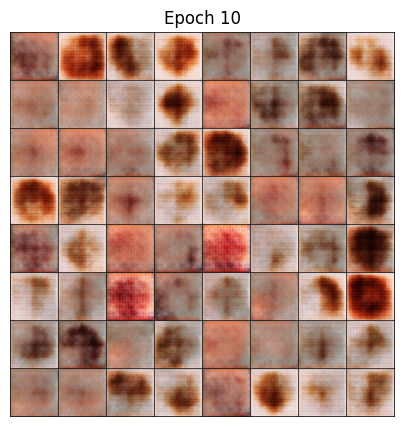

Epoch  11/300   Loss_D: 0.9653   Loss_G: 2.1866
Epoch  12/300   Loss_D: 0.7368   Loss_G: 2.4803
Epoch  13/300   Loss_D: 1.2180   Loss_G: 2.5315
Epoch  14/300   Loss_D: 0.9814   Loss_G: 2.3648
Epoch  15/300   Loss_D: 1.2713   Loss_G: 2.0837


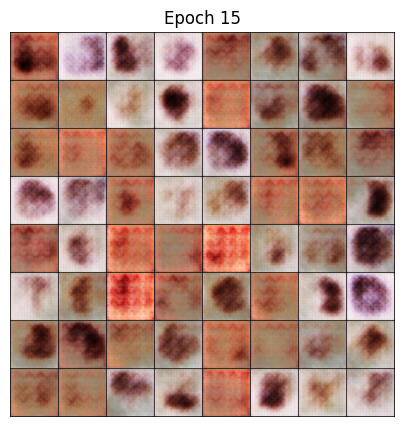

Epoch  16/300   Loss_D: 0.8515   Loss_G: 2.1582
Epoch  17/300   Loss_D: 1.2225   Loss_G: 2.0030
Epoch  18/300   Loss_D: 1.0663   Loss_G: 2.0764
Epoch  19/300   Loss_D: 0.9942   Loss_G: 1.8598
Epoch  20/300   Loss_D: 0.8797   Loss_G: 2.2458


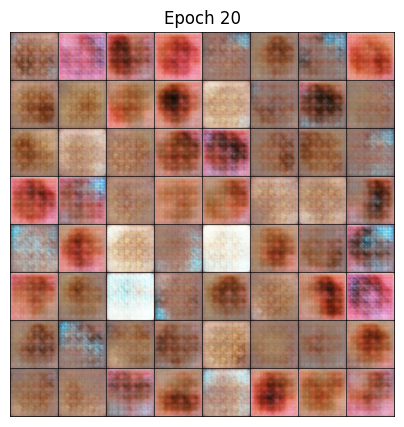

Epoch  21/300   Loss_D: 1.0590   Loss_G: 2.0985
Epoch  22/300   Loss_D: 0.9609   Loss_G: 2.2586
Epoch  23/300   Loss_D: 1.3467   Loss_G: 2.2927
Epoch  24/300   Loss_D: 1.0260   Loss_G: 1.7417
Epoch  25/300   Loss_D: 1.0611   Loss_G: 1.9712


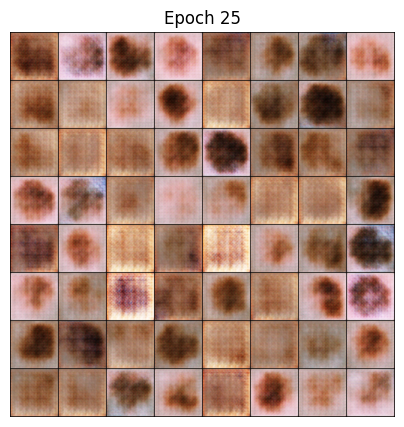

Epoch  26/300   Loss_D: 0.8776   Loss_G: 1.8651
Epoch  27/300   Loss_D: 1.1813   Loss_G: 1.9310
Epoch  28/300   Loss_D: 0.9848   Loss_G: 1.9627
Epoch  29/300   Loss_D: 1.2795   Loss_G: 1.9252
Epoch  30/300   Loss_D: 0.9532   Loss_G: 1.9984


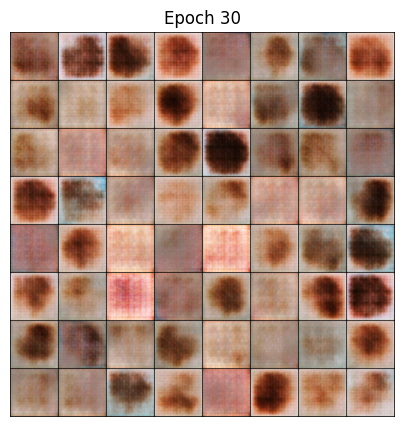

Epoch  31/300   Loss_D: 1.1628   Loss_G: 1.6637
Epoch  32/300   Loss_D: 0.9286   Loss_G: 1.7646
Epoch  33/300   Loss_D: 0.9996   Loss_G: 1.8707
Epoch  34/300   Loss_D: 1.0266   Loss_G: 1.9359
Epoch  35/300   Loss_D: 0.9603   Loss_G: 1.9318


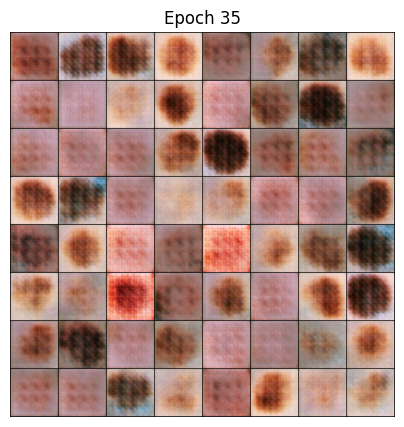

Epoch  36/300   Loss_D: 1.0858   Loss_G: 1.8393
Epoch  37/300   Loss_D: 1.1730   Loss_G: 2.1289
Epoch  38/300   Loss_D: 0.9626   Loss_G: 1.9073
Epoch  39/300   Loss_D: 1.0543   Loss_G: 1.9418
Epoch  40/300   Loss_D: 0.8648   Loss_G: 1.9684


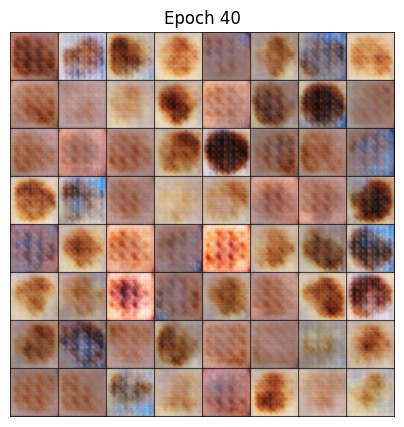

Epoch  41/300   Loss_D: 1.2780   Loss_G: 1.8409
Epoch  42/300   Loss_D: 0.8321   Loss_G: 1.7923
Epoch  43/300   Loss_D: 1.0016   Loss_G: 2.1382
Epoch  44/300   Loss_D: 1.0244   Loss_G: 1.8005
Epoch  45/300   Loss_D: 1.0582   Loss_G: 1.9217


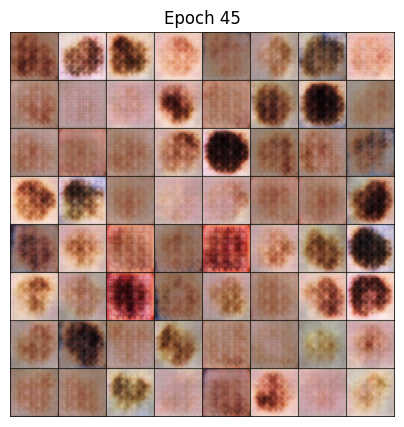

Epoch  46/300   Loss_D: 0.9270   Loss_G: 1.8552
Epoch  47/300   Loss_D: 1.1237   Loss_G: 1.8756
Epoch  48/300   Loss_D: 1.1560   Loss_G: 1.7967
Epoch  49/300   Loss_D: 1.0957   Loss_G: 2.0763
Epoch  50/300   Loss_D: 1.0650   Loss_G: 1.7873


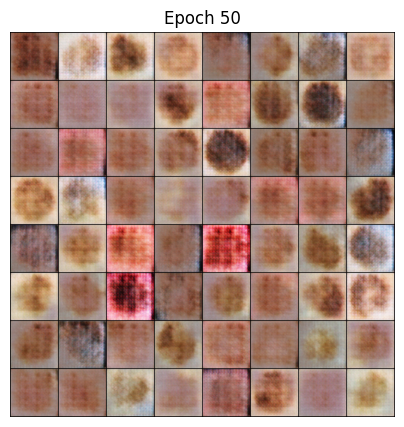

Epoch  51/300   Loss_D: 1.0680   Loss_G: 1.9757
Epoch  52/300   Loss_D: 1.0781   Loss_G: 1.7778
Epoch  53/300   Loss_D: 0.9618   Loss_G: 1.8569
Epoch  54/300   Loss_D: 0.9879   Loss_G: 1.8757
Epoch  55/300   Loss_D: 0.9640   Loss_G: 1.9134


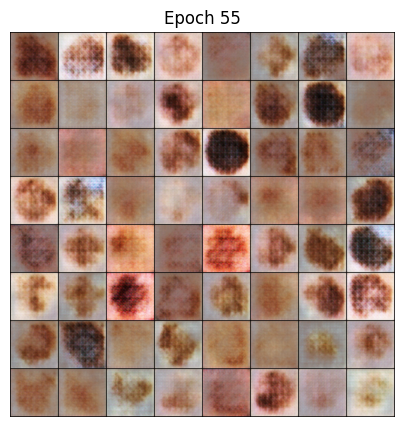

Epoch  56/300   Loss_D: 1.0498   Loss_G: 1.8721
Epoch  57/300   Loss_D: 0.9153   Loss_G: 1.8029
Epoch  58/300   Loss_D: 1.0637   Loss_G: 1.8566
Epoch  59/300   Loss_D: 1.1146   Loss_G: 2.1108
Epoch  60/300   Loss_D: 0.9183   Loss_G: 2.2138


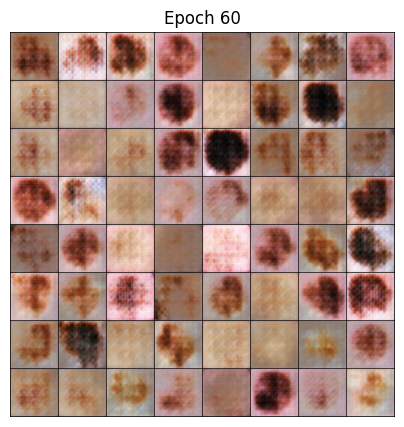

Epoch  61/300   Loss_D: 1.0756   Loss_G: 1.6830
Epoch  62/300   Loss_D: 1.0930   Loss_G: 1.7730
Epoch  63/300   Loss_D: 0.8432   Loss_G: 1.8359
Epoch  64/300   Loss_D: 0.9965   Loss_G: 1.9774
Epoch  65/300   Loss_D: 0.9154   Loss_G: 1.9594


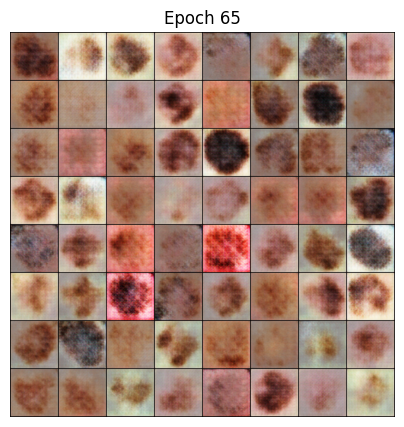

Epoch  66/300   Loss_D: 0.9936   Loss_G: 1.7842
Epoch  67/300   Loss_D: 1.0463   Loss_G: 1.9348
Epoch  68/300   Loss_D: 0.8660   Loss_G: 1.8581
Epoch  69/300   Loss_D: 0.8862   Loss_G: 2.0136
Epoch  70/300   Loss_D: 0.8447   Loss_G: 2.2536


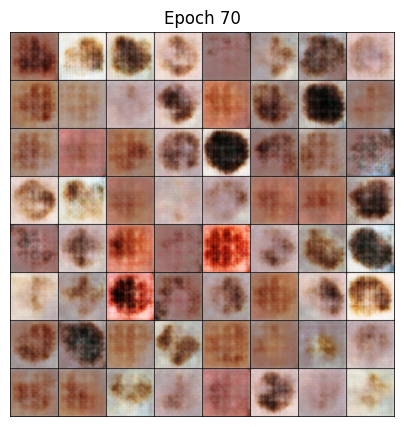

Epoch  71/300   Loss_D: 0.9385   Loss_G: 1.7898
Epoch  72/300   Loss_D: 0.9904   Loss_G: 1.9714
Epoch  73/300   Loss_D: 0.9071   Loss_G: 1.9418
Epoch  74/300   Loss_D: 1.0136   Loss_G: 2.1415
Epoch  75/300   Loss_D: 0.9507   Loss_G: 1.8209


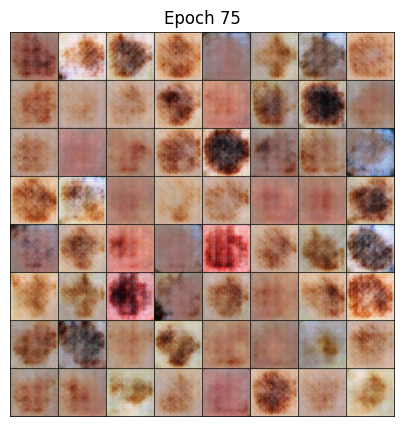

Epoch  76/300   Loss_D: 0.9317   Loss_G: 1.9817
Epoch  77/300   Loss_D: 0.8684   Loss_G: 1.7028
Epoch  78/300   Loss_D: 1.0290   Loss_G: 2.0512
Epoch  79/300   Loss_D: 0.8559   Loss_G: 1.8900
Epoch  80/300   Loss_D: 0.7575   Loss_G: 2.1872


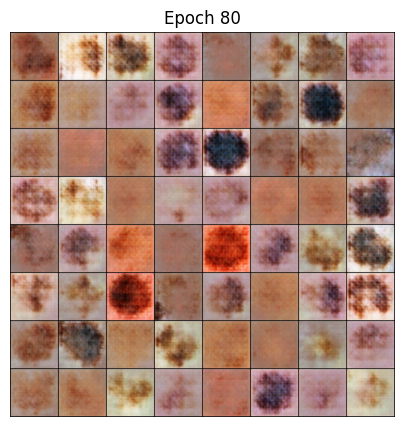

Epoch  81/300   Loss_D: 0.8647   Loss_G: 2.1192
Epoch  82/300   Loss_D: 0.9045   Loss_G: 1.9428
Epoch  83/300   Loss_D: 0.8146   Loss_G: 2.2753
Epoch  84/300   Loss_D: 0.9503   Loss_G: 2.2681
Epoch  85/300   Loss_D: 0.9609   Loss_G: 1.9801


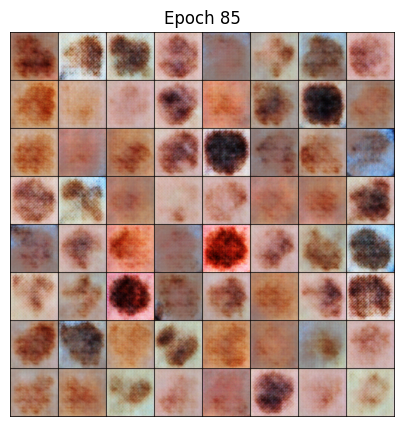

Epoch  86/300   Loss_D: 0.8331   Loss_G: 1.9958
Epoch  87/300   Loss_D: 0.8586   Loss_G: 2.0484
Epoch  88/300   Loss_D: 0.7431   Loss_G: 2.0628
Epoch  89/300   Loss_D: 0.8656   Loss_G: 2.0111
Epoch  90/300   Loss_D: 0.7742   Loss_G: 2.1179


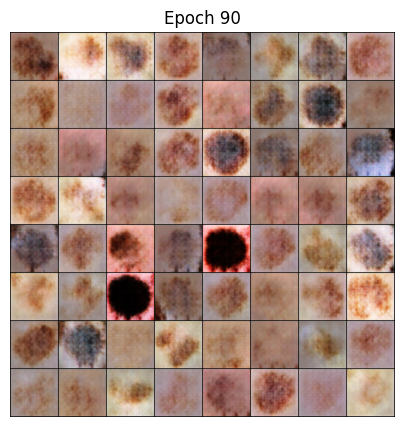

Epoch  91/300   Loss_D: 0.8019   Loss_G: 2.3310
Epoch  92/300   Loss_D: 0.9221   Loss_G: 2.1253
Epoch  93/300   Loss_D: 0.7597   Loss_G: 2.0877
Epoch  94/300   Loss_D: 0.8635   Loss_G: 2.2932
Epoch  95/300   Loss_D: 0.8248   Loss_G: 2.1890


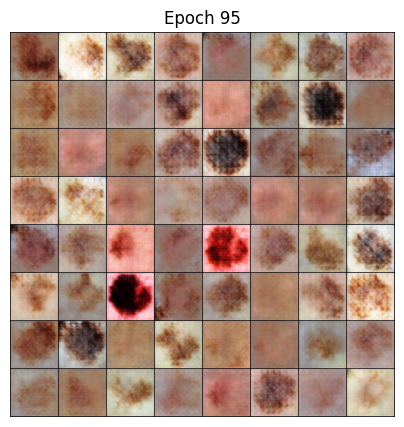

Epoch  96/300   Loss_D: 0.8502   Loss_G: 2.0740
Epoch  97/300   Loss_D: 0.7996   Loss_G: 2.2433
Epoch  98/300   Loss_D: 0.7876   Loss_G: 2.2278
Epoch  99/300   Loss_D: 0.7507   Loss_G: 2.4629
Epoch 100/300   Loss_D: 0.7243   Loss_G: 2.1986


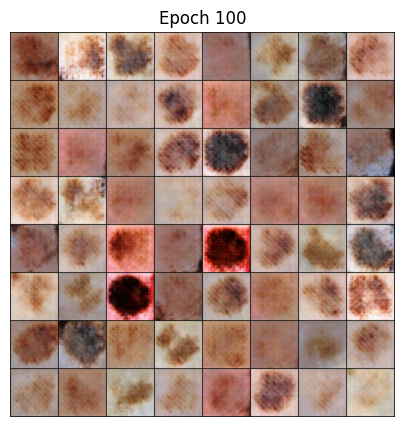

Epoch 101/300   Loss_D: 0.8090   Loss_G: 2.2659
Epoch 102/300   Loss_D: 0.6438   Loss_G: 2.2678
Epoch 103/300   Loss_D: 0.8631   Loss_G: 2.7923
Epoch 104/300   Loss_D: 0.7026   Loss_G: 2.3496
Epoch 105/300   Loss_D: 0.6826   Loss_G: 2.5295


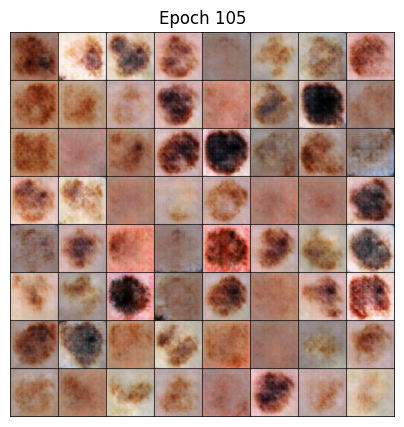

Epoch 106/300   Loss_D: 0.6307   Loss_G: 2.5096
Epoch 107/300   Loss_D: 0.7937   Loss_G: 2.4961
Epoch 108/300   Loss_D: 0.8048   Loss_G: 2.6203
Epoch 109/300   Loss_D: 0.6482   Loss_G: 2.2867
Epoch 110/300   Loss_D: 0.7764   Loss_G: 2.4896


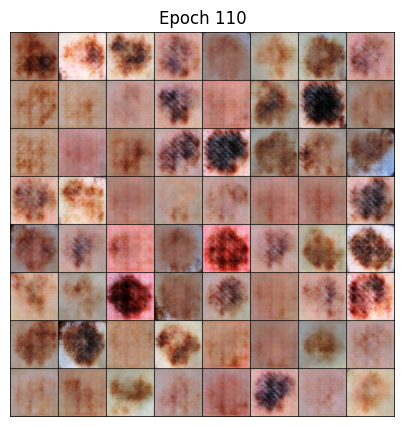

Epoch 111/300   Loss_D: 0.7893   Loss_G: 2.5521
Epoch 112/300   Loss_D: 0.5746   Loss_G: 2.2928
Epoch 113/300   Loss_D: 0.5837   Loss_G: 2.4774
Epoch 114/300   Loss_D: 0.5647   Loss_G: 2.7045
Epoch 115/300   Loss_D: 0.7382   Loss_G: 2.4778


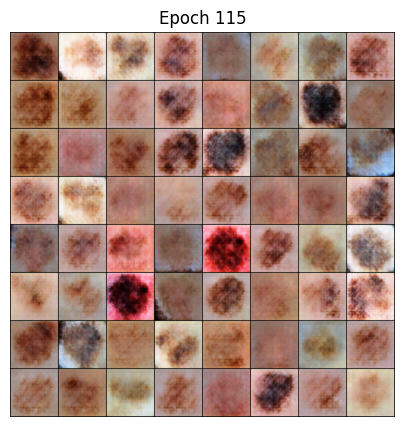

Epoch 116/300   Loss_D: 0.6368   Loss_G: 2.4414
Epoch 117/300   Loss_D: 0.6413   Loss_G: 2.4154
Epoch 118/300   Loss_D: 0.7023   Loss_G: 2.5211
Epoch 119/300   Loss_D: 0.8250   Loss_G: 2.4388
Epoch 120/300   Loss_D: 0.6291   Loss_G: 2.7019


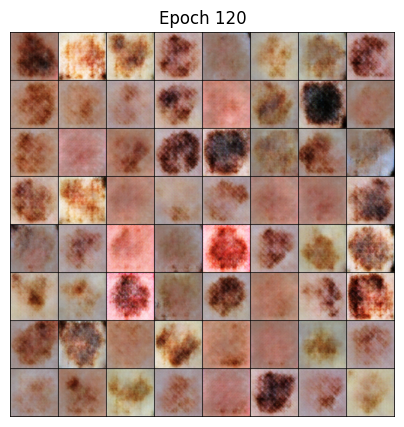

Epoch 121/300   Loss_D: 0.5393   Loss_G: 2.6920
Epoch 122/300   Loss_D: 0.6216   Loss_G: 3.2056
Epoch 123/300   Loss_D: 0.5993   Loss_G: 2.9135
Epoch 124/300   Loss_D: 0.5550   Loss_G: 2.7948
Epoch 125/300   Loss_D: 0.6714   Loss_G: 2.8774


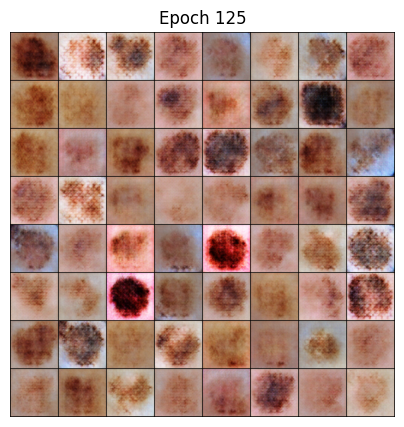

Epoch 126/300   Loss_D: 0.6790   Loss_G: 2.9401
Epoch 127/300   Loss_D: 0.5139   Loss_G: 2.9583
Epoch 128/300   Loss_D: 0.6325   Loss_G: 3.1642
Epoch 129/300   Loss_D: 0.6489   Loss_G: 2.6705
Epoch 130/300   Loss_D: 0.6409   Loss_G: 2.9875


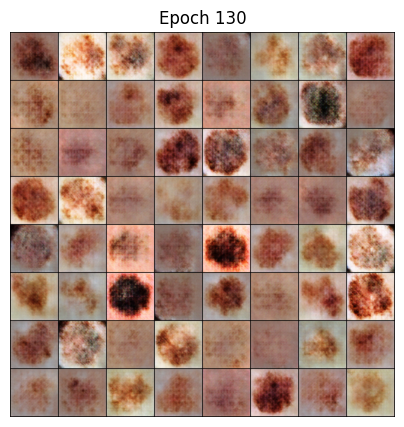

Epoch 131/300   Loss_D: 0.6660   Loss_G: 3.1160
Epoch 132/300   Loss_D: 0.6901   Loss_G: 3.1753
Epoch 133/300   Loss_D: 0.4992   Loss_G: 2.7924
Epoch 134/300   Loss_D: 0.5773   Loss_G: 3.0145
Epoch 135/300   Loss_D: 0.4896   Loss_G: 2.9842


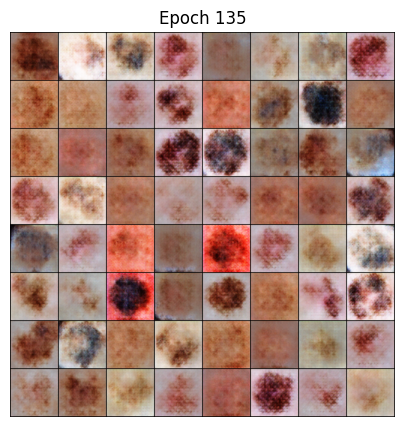

Epoch 136/300   Loss_D: 0.5369   Loss_G: 2.7467
Epoch 137/300   Loss_D: 0.4600   Loss_G: 2.7652
Epoch 138/300   Loss_D: 0.4635   Loss_G: 2.8673
Epoch 139/300   Loss_D: 0.5141   Loss_G: 3.0644
Epoch 140/300   Loss_D: 0.5805   Loss_G: 2.7356


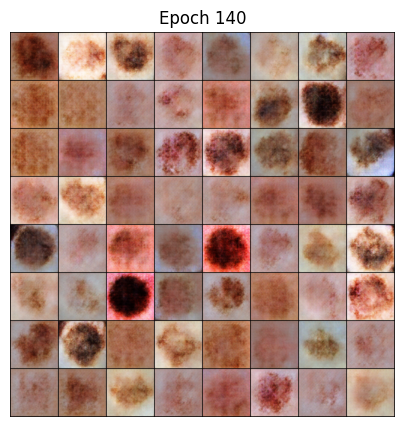

Epoch 141/300   Loss_D: 0.4222   Loss_G: 2.6093
Epoch 142/300   Loss_D: 0.4907   Loss_G: 3.1189
Epoch 143/300   Loss_D: 0.4920   Loss_G: 3.1578
Epoch 144/300   Loss_D: 0.4922   Loss_G: 3.3456
Epoch 145/300   Loss_D: 0.4201   Loss_G: 3.0338


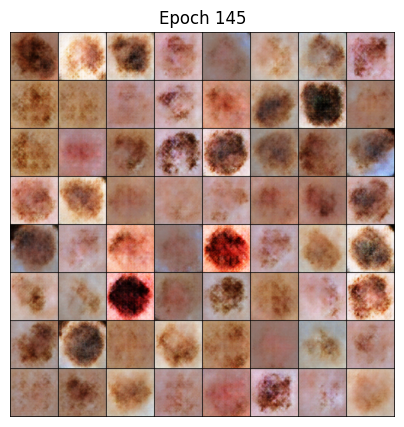

Epoch 146/300   Loss_D: 0.4357   Loss_G: 2.8635
Epoch 147/300   Loss_D: 0.4968   Loss_G: 3.2395
Epoch 148/300   Loss_D: 0.6863   Loss_G: 3.0753
Epoch 149/300   Loss_D: 0.6534   Loss_G: 3.1989
Epoch 150/300   Loss_D: 0.5644   Loss_G: 3.0803


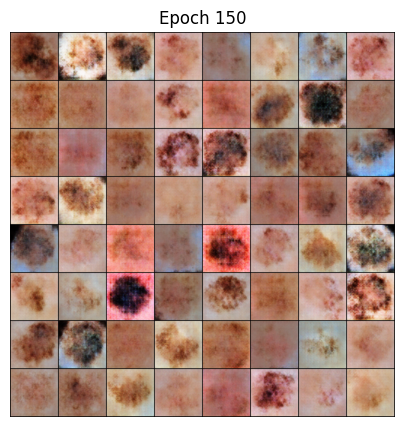

Epoch 151/300   Loss_D: 0.5074   Loss_G: 3.3740
Epoch 152/300   Loss_D: 0.4695   Loss_G: 3.4430
Epoch 153/300   Loss_D: 0.4939   Loss_G: 3.2514
Epoch 154/300   Loss_D: 0.4340   Loss_G: 3.3888
Epoch 155/300   Loss_D: 0.5479   Loss_G: 3.4594


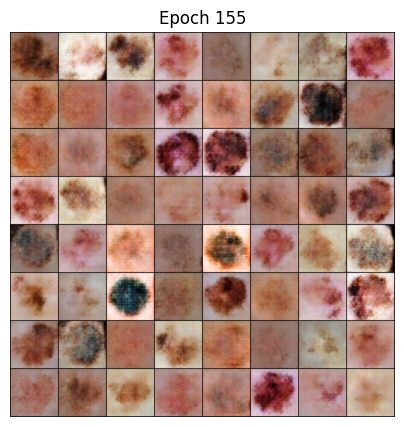

Epoch 156/300   Loss_D: 0.4327   Loss_G: 3.2437
Epoch 157/300   Loss_D: 0.3927   Loss_G: 3.3135
Epoch 158/300   Loss_D: 0.4737   Loss_G: 3.1108
Epoch 159/300   Loss_D: 0.3638   Loss_G: 3.2828
Epoch 160/300   Loss_D: 0.3312   Loss_G: 3.1791


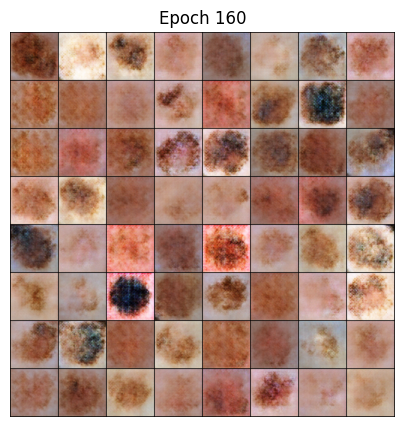

Epoch 161/300   Loss_D: 0.3577   Loss_G: 3.6395
Epoch 162/300   Loss_D: 0.3365   Loss_G: 3.4170
Epoch 163/300   Loss_D: 0.3597   Loss_G: 3.4264
Epoch 164/300   Loss_D: 0.5106   Loss_G: 3.8126
Epoch 165/300   Loss_D: 0.3955   Loss_G: 3.5059


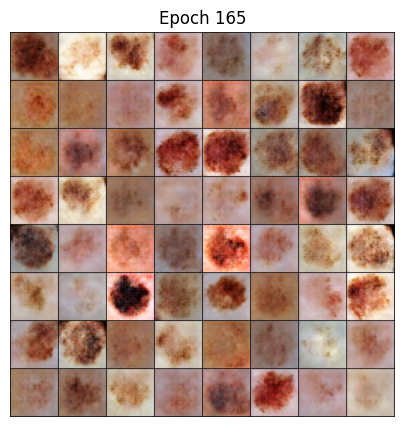

Epoch 166/300   Loss_D: 0.4427   Loss_G: 3.7887
Epoch 167/300   Loss_D: 0.5880   Loss_G: 3.7394
Epoch 168/300   Loss_D: 0.5016   Loss_G: 3.6203
Epoch 169/300   Loss_D: 0.3605   Loss_G: 3.9017
Epoch 170/300   Loss_D: 0.4003   Loss_G: 3.8106


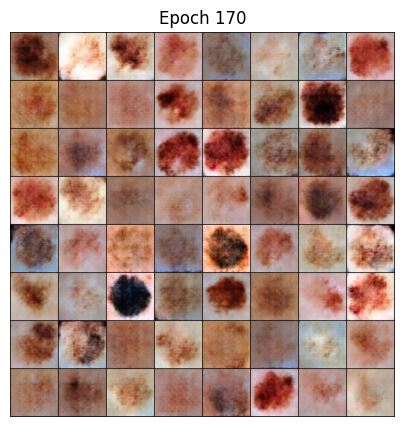

Epoch 171/300   Loss_D: 0.4053   Loss_G: 3.3698
Epoch 172/300   Loss_D: 0.4852   Loss_G: 3.6445
Epoch 173/300   Loss_D: 0.3956   Loss_G: 3.7896
Epoch 174/300   Loss_D: 0.3329   Loss_G: 3.9582
Epoch 175/300   Loss_D: 0.3304   Loss_G: 3.2581


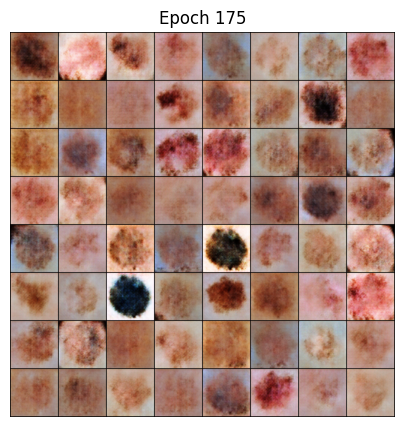

Epoch 176/300   Loss_D: 0.3025   Loss_G: 4.0321
Epoch 177/300   Loss_D: 0.2854   Loss_G: 3.8347
Epoch 178/300   Loss_D: 0.4343   Loss_G: 4.2278
Epoch 179/300   Loss_D: 0.3798   Loss_G: 3.5894
Epoch 180/300   Loss_D: 0.3915   Loss_G: 3.3315


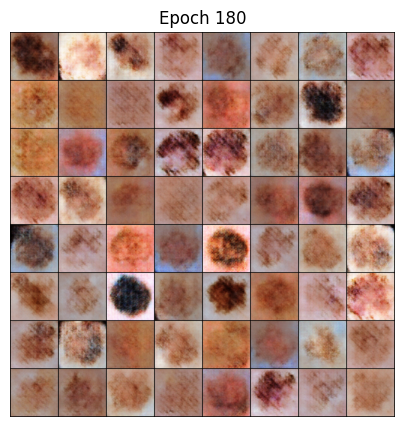

Epoch 181/300   Loss_D: 0.3147   Loss_G: 3.8110
Epoch 182/300   Loss_D: 0.3024   Loss_G: 3.8751
Epoch 183/300   Loss_D: 0.4161   Loss_G: 4.0730
Epoch 184/300   Loss_D: 0.3528   Loss_G: 3.8273
Epoch 185/300   Loss_D: 0.3148   Loss_G: 3.7470


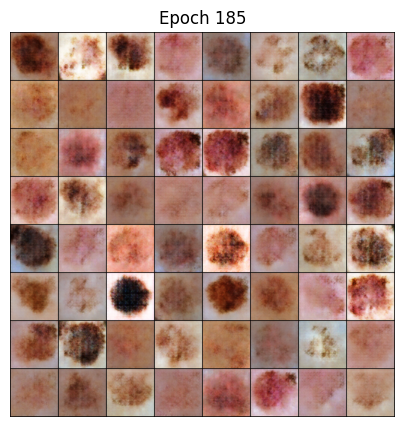

Epoch 186/300   Loss_D: 0.3471   Loss_G: 3.9700
Epoch 187/300   Loss_D: 0.4375   Loss_G: 4.2650
Epoch 188/300   Loss_D: 0.2765   Loss_G: 3.7094
Epoch 189/300   Loss_D: 0.3909   Loss_G: 3.8824
Epoch 190/300   Loss_D: 0.2857   Loss_G: 3.7428


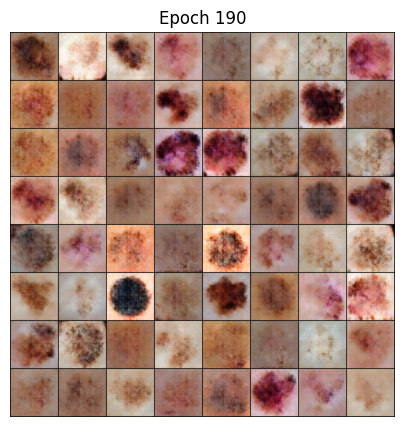

Epoch 191/300   Loss_D: 0.2433   Loss_G: 4.0009
Epoch 192/300   Loss_D: 0.3148   Loss_G: 4.2047
Epoch 193/300   Loss_D: 0.5060   Loss_G: 3.6942
Epoch 194/300   Loss_D: 0.4106   Loss_G: 4.2680
Epoch 195/300   Loss_D: 0.3792   Loss_G: 4.1623


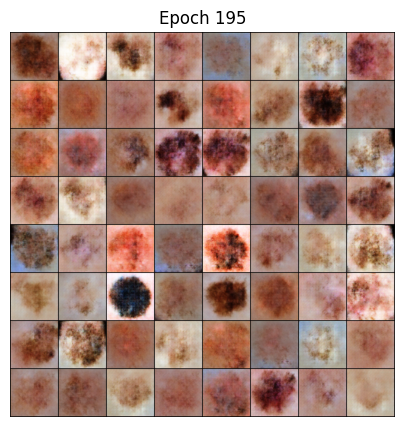

Epoch 196/300   Loss_D: 0.3256   Loss_G: 4.0411
Epoch 197/300   Loss_D: 0.2231   Loss_G: 3.8722
Epoch 198/300   Loss_D: 0.3231   Loss_G: 3.9536
Epoch 199/300   Loss_D: 0.3214   Loss_G: 4.0787
Epoch 200/300   Loss_D: 0.3192   Loss_G: 4.0982


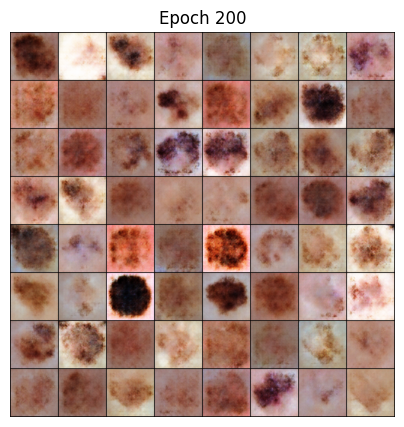

Epoch 201/300   Loss_D: 0.4103   Loss_G: 4.2553
Epoch 202/300   Loss_D: 0.2765   Loss_G: 4.0370
Epoch 203/300   Loss_D: 0.2803   Loss_G: 4.1820
Epoch 204/300   Loss_D: 0.3102   Loss_G: 4.1234
Epoch 205/300   Loss_D: 0.2619   Loss_G: 3.9218


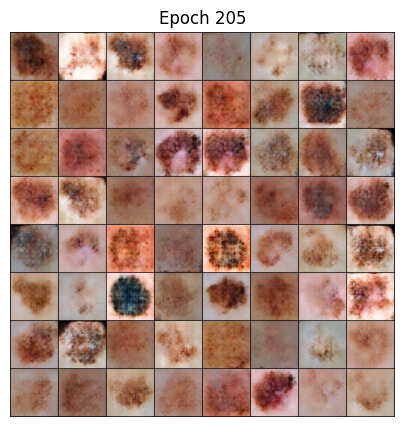

Epoch 206/300   Loss_D: 0.2645   Loss_G: 3.8026
Epoch 207/300   Loss_D: 0.2390   Loss_G: 4.4395
Epoch 208/300   Loss_D: 0.3226   Loss_G: 4.1197
Epoch 209/300   Loss_D: 0.3530   Loss_G: 4.1612
Epoch 210/300   Loss_D: 0.3778   Loss_G: 4.6640


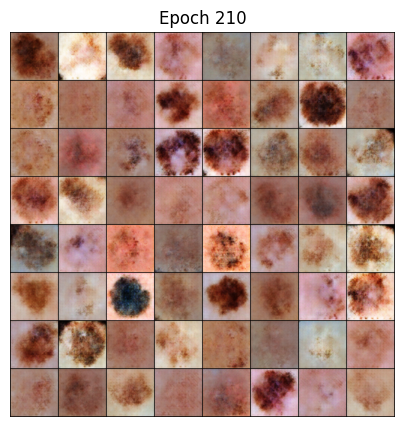

Epoch 211/300   Loss_D: 0.4331   Loss_G: 4.1232
Epoch 212/300   Loss_D: 0.2450   Loss_G: 4.5760
Epoch 213/300   Loss_D: 0.2159   Loss_G: 4.0296
Epoch 214/300   Loss_D: 0.3474   Loss_G: 4.2792
Epoch 215/300   Loss_D: 0.2110   Loss_G: 3.9827


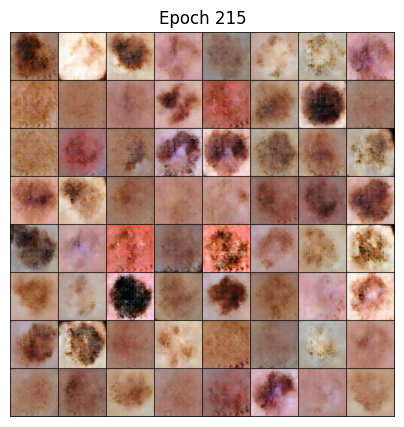

Epoch 216/300   Loss_D: 0.1931   Loss_G: 3.9126
Epoch 217/300   Loss_D: 0.2536   Loss_G: 4.4015
Epoch 218/300   Loss_D: 0.3146   Loss_G: 4.3805
Epoch 219/300   Loss_D: 0.3687   Loss_G: 4.3692
Epoch 220/300   Loss_D: 0.3162   Loss_G: 4.4925


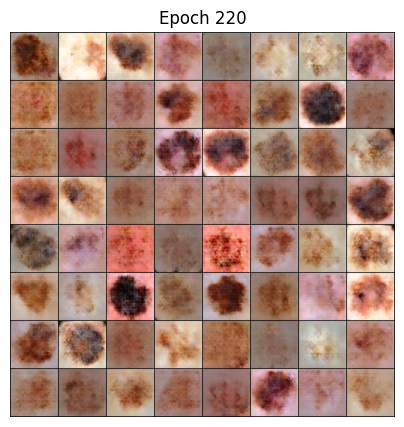

Epoch 221/300   Loss_D: 0.6454   Loss_G: 4.5696
Epoch 222/300   Loss_D: 0.3591   Loss_G: 3.8134
Epoch 223/300   Loss_D: 0.3479   Loss_G: 4.7449
Epoch 224/300   Loss_D: 0.3068   Loss_G: 4.0523
Epoch 225/300   Loss_D: 0.2254   Loss_G: 4.1772


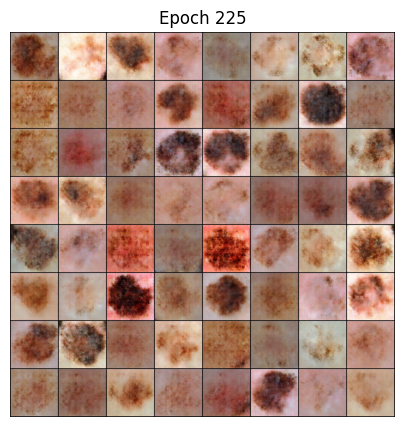

Epoch 226/300   Loss_D: 0.1984   Loss_G: 4.1792
Epoch 227/300   Loss_D: 0.1981   Loss_G: 4.3163
Epoch 228/300   Loss_D: 0.1740   Loss_G: 4.0791
Epoch 229/300   Loss_D: 0.1962   Loss_G: 4.2589
Epoch 230/300   Loss_D: 0.2451   Loss_G: 4.1248


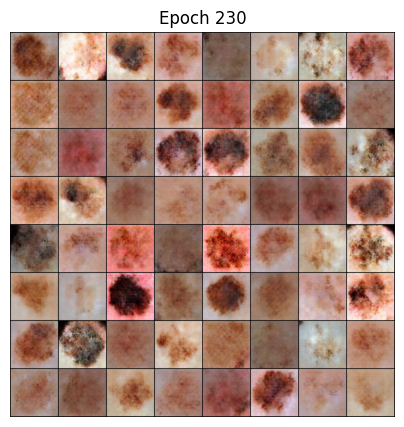

Epoch 231/300   Loss_D: 0.1778   Loss_G: 4.4661
Epoch 232/300   Loss_D: 0.2154   Loss_G: 4.4228
Epoch 233/300   Loss_D: 0.1724   Loss_G: 4.0817
Epoch 234/300   Loss_D: 0.2282   Loss_G: 4.6491
Epoch 235/300   Loss_D: 0.1833   Loss_G: 4.8842


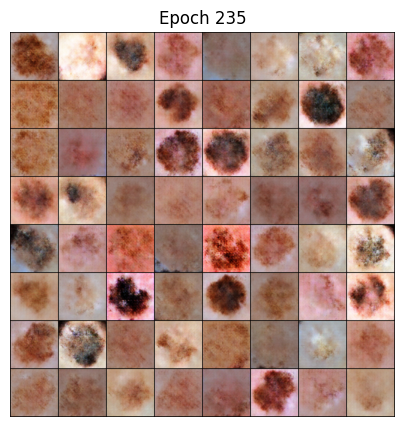

Epoch 236/300   Loss_D: 0.1527   Loss_G: 4.4100
Epoch 237/300   Loss_D: 0.1293   Loss_G: 4.3431
Epoch 238/300   Loss_D: 0.1735   Loss_G: 4.2472
Epoch 239/300   Loss_D: 0.3232   Loss_G: 4.9769
Epoch 240/300   Loss_D: 0.2553   Loss_G: 4.7024


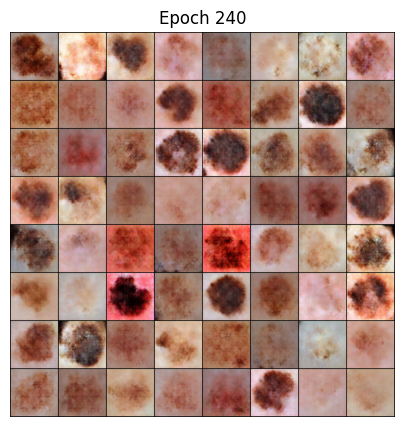

Epoch 241/300   Loss_D: 0.3056   Loss_G: 4.7508
Epoch 242/300   Loss_D: 0.2475   Loss_G: 4.0552
Epoch 243/300   Loss_D: 0.1810   Loss_G: 4.6479
Epoch 244/300   Loss_D: 0.1917   Loss_G: 4.6909
Epoch 245/300   Loss_D: 0.1481   Loss_G: 4.4407


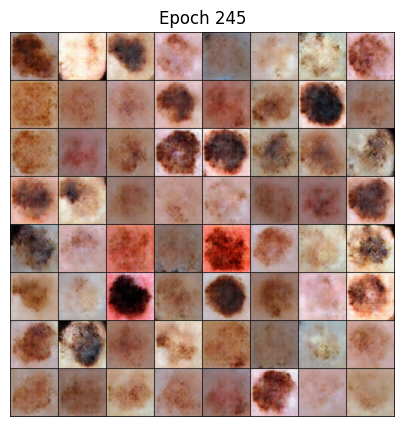

Epoch 246/300   Loss_D: 0.1456   Loss_G: 4.2709
Epoch 247/300   Loss_D: 0.1475   Loss_G: 4.6495
Epoch 248/300   Loss_D: 0.1239   Loss_G: 4.5560
Epoch 249/300   Loss_D: 0.1550   Loss_G: 4.3779
Epoch 250/300   Loss_D: 0.1479   Loss_G: 4.6978


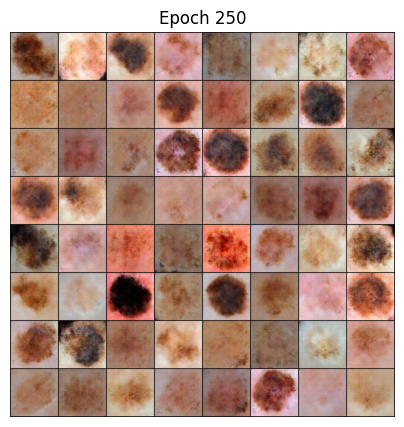

Epoch 251/300   Loss_D: 0.2155   Loss_G: 4.8248
Epoch 252/300   Loss_D: 0.3598   Loss_G: 4.4635
Epoch 253/300   Loss_D: 0.3395   Loss_G: 4.7154
Epoch 254/300   Loss_D: 0.4173   Loss_G: 4.9440
Epoch 255/300   Loss_D: 0.2622   Loss_G: 4.9189


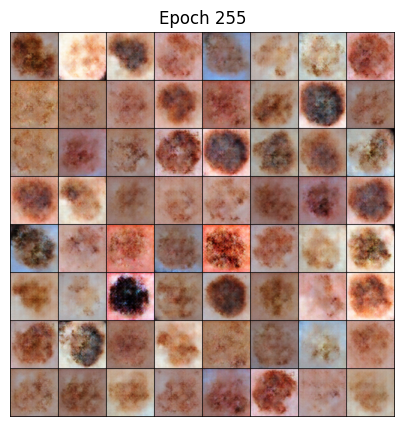

Epoch 256/300   Loss_D: 0.1822   Loss_G: 4.7165
Epoch 257/300   Loss_D: 0.4564   Loss_G: 5.3146
Epoch 258/300   Loss_D: 0.2436   Loss_G: 5.1093
Epoch 259/300   Loss_D: 0.1561   Loss_G: 4.5079
Epoch 260/300   Loss_D: 0.1617   Loss_G: 4.7466


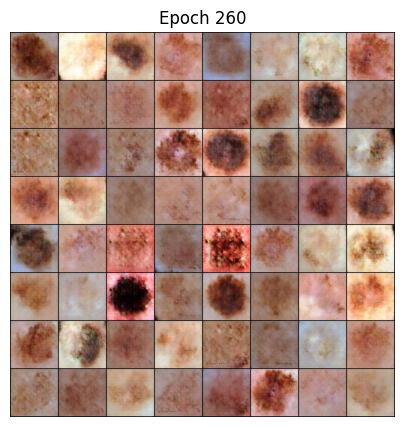

Epoch 261/300   Loss_D: 0.2228   Loss_G: 4.5730
Epoch 262/300   Loss_D: 0.1364   Loss_G: 4.8762
Epoch 263/300   Loss_D: 0.1209   Loss_G: 4.4611
Epoch 264/300   Loss_D: 0.1547   Loss_G: 4.1908
Epoch 265/300   Loss_D: 0.5326   Loss_G: 5.5209


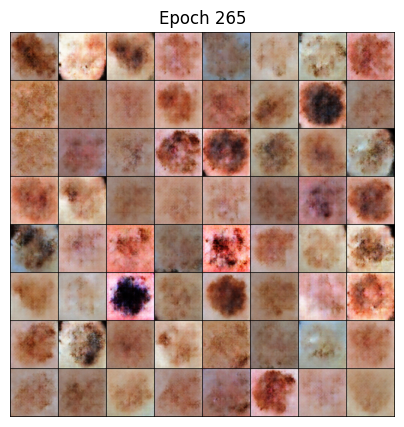

Epoch 266/300   Loss_D: 0.2240   Loss_G: 5.2632
Epoch 267/300   Loss_D: 0.2048   Loss_G: 5.1087
Epoch 268/300   Loss_D: 0.2228   Loss_G: 5.2680
Epoch 269/300   Loss_D: 0.1236   Loss_G: 4.7809
Epoch 270/300   Loss_D: 0.1082   Loss_G: 4.5758


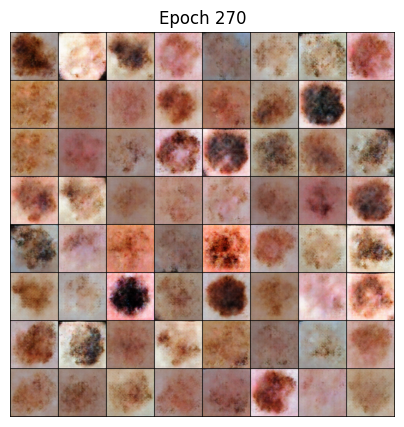

Epoch 271/300   Loss_D: 0.1347   Loss_G: 5.4476
Epoch 272/300   Loss_D: 0.1118   Loss_G: 4.8652
Epoch 273/300   Loss_D: 0.1430   Loss_G: 5.0730
Epoch 274/300   Loss_D: 0.1418   Loss_G: 5.1420
Epoch 275/300   Loss_D: 0.0997   Loss_G: 4.9999


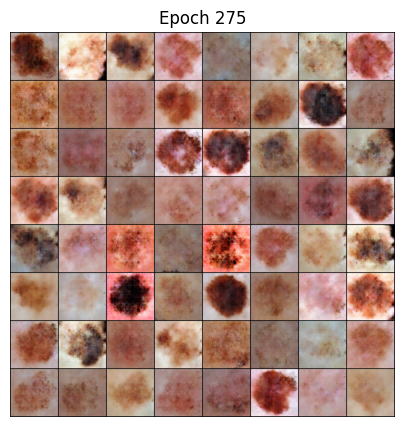

Epoch 276/300   Loss_D: 0.0968   Loss_G: 4.8461
Epoch 277/300   Loss_D: 0.0774   Loss_G: 5.2108
Epoch 278/300   Loss_D: 0.0853   Loss_G: 5.0117
Epoch 279/300   Loss_D: 0.1269   Loss_G: 5.5069
Epoch 280/300   Loss_D: 0.3842   Loss_G: 5.1914


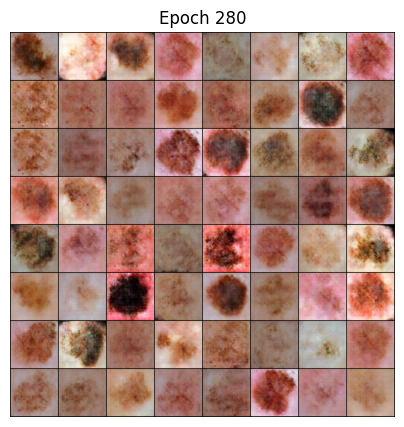

Epoch 281/300   Loss_D: 0.3683   Loss_G: 5.4318
Epoch 282/300   Loss_D: 0.3402   Loss_G: 5.4296
Epoch 283/300   Loss_D: 0.2567   Loss_G: 5.1347
Epoch 284/300   Loss_D: 0.2039   Loss_G: 5.0509
Epoch 285/300   Loss_D: 0.1041   Loss_G: 4.9964


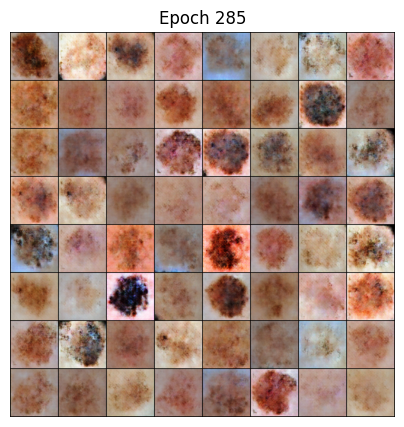

Epoch 286/300   Loss_D: 0.1225   Loss_G: 4.9676
Epoch 287/300   Loss_D: 0.0812   Loss_G: 5.0594
Epoch 288/300   Loss_D: 0.1355   Loss_G: 4.7628
Epoch 289/300   Loss_D: 0.0879   Loss_G: 4.7585
Epoch 290/300   Loss_D: 0.0986   Loss_G: 4.5575


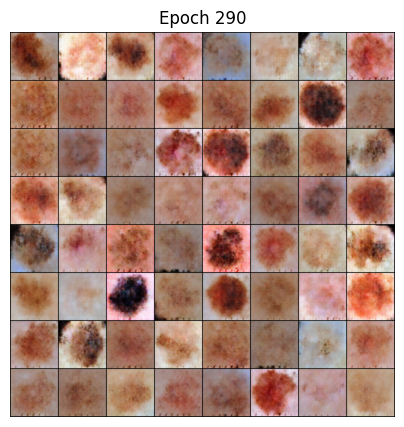

Epoch 291/300   Loss_D: 0.1769   Loss_G: 5.0681
Epoch 292/300   Loss_D: 0.1265   Loss_G: 5.3603
Epoch 293/300   Loss_D: 0.0804   Loss_G: 5.1590
Epoch 294/300   Loss_D: 0.0872   Loss_G: 4.6419
Epoch 295/300   Loss_D: 0.0970   Loss_G: 4.7515


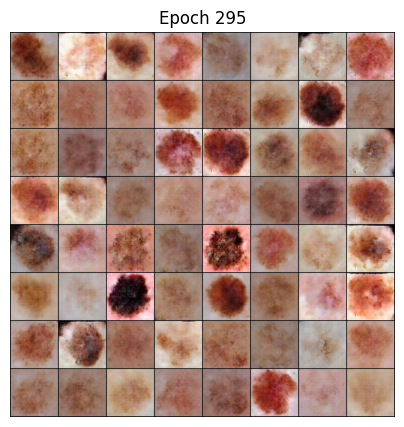

Epoch 296/300   Loss_D: 0.2099   Loss_G: 5.1531
Epoch 297/300   Loss_D: 2.1629   Loss_G: 4.0162
Epoch 298/300   Loss_D: 1.0477   Loss_G: 3.2599
Epoch 299/300   Loss_D: 0.7646   Loss_G: 3.9372
Epoch 300/300   Loss_D: 0.5383   Loss_G: 4.4035


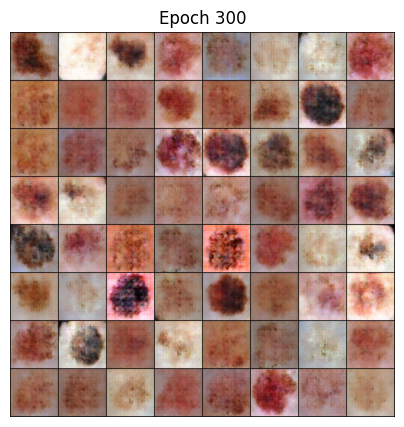

In [ ]:
# Training loop & periodic visualization

# For each epoch
for epoch in range(1, n_epochs+1):
    runningD = 0.0
    runningG = 0.0
    batches  = 0

    for real_images, _ in dataloader:
        real_images = real_images.to(device)
        b_size      = real_images.size(0)
        batches    += 1

        # ——— D  ———
        lossD = 0.0
        for _ in range(d_steps):
            D.zero_grad()
            # real
            label_real = torch.full((b_size,), real_label, device=device)
            out_real   = D(real_images)
            lossD_real = criterion(out_real, label_real)

            # fake

            # Sample
            noise      = torch.randn(b_size, nz, 1, 1, device=device)
            fake_imgs  = G(noise).detach()
            label_fake = torch.full((b_size,), fake_label, device=device)
            out_fake   = D(fake_imgs)
            lossD_fake = criterion(out_fake, label_fake)

            lossD = lossD_real + lossD_fake
            lossD.backward()
            optimizerD.step()

        runningD += lossD.item()

        # ——— G  ———
        G.zero_grad()
        noise     = torch.randn(b_size, nz, 1, 1, device=device)
        fake_imgs = G(noise)
        label_G   = torch.full((b_size,), real_label, device=device)  # we want D(fake) → real
        outG      = D(fake_imgs)
        lossG     = criterion(outG, label_G)
        lossG.backward()
        optimizerG.step()

        runningG += lossG.item()

    # end of epoch: print avg losses
    avgD = runningD / batches
    avgG = runningG / batches
    print(f"Epoch {epoch:3d}/{n_epochs}   Loss_D: {avgD:.4f}   Loss_G: {avgG:.4f}")

    # every 5 epochs (and epoch 1), show samples
    if epoch == 1 or epoch % 5 == 0:
        with torch.no_grad():
            samples = G(fixed_noise).cpu()
        grid = vutils.make_grid(samples, normalize=True, nrow=8, padding=2)
        plt.figure(figsize=(5,5))
        plt.axis('off')
        plt.title(f"Epoch {epoch}")
        plt.imshow(np.transpose(grid, (1,2,0)))
        plt.show()

     # ——— SAVE SNAPSHOT ———
    if epoch % 10 == 0:
        torch.save(G.state_dict(), f"generator_epoch{epoch}.pth")


In [ ]:
# save G
torch.save(G.state_dict(), "dcgan_generator_final.pth")
print("Generator saved.")


Generator saved.


In [ ]:
from google.colab import files

files.download("generator_epoch170.pth")


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import torchvision.utils as vutils
from pathlib import Path

G = Generator().to(device)
G.load_state_dict(torch.load("generator_epoch170.pth", map_location=device))
G.eval()

N_SYN = 1000

OUT_DIR = Path("/content/drive/MyDrive/ISIC2017/synthetic_melanoma")
OUT_DIR.mkdir(exist_ok=True, parents=True)

with torch.no_grad():
    noise = torch.randn(N_SYN, nz, 1, 1, device=device)
    fake  = G(noise).cpu()          # shape [N_SYN,3,128,128]
    fake  = (fake + 1) / 2         # rescale [–1,+1]→[0,1]

for i, img in enumerate(fake):
    vutils.save_image(img, OUT_DIR / f"dcgan_{i:04d}.png")

print(f"Saved {N_SYN} synthetic images to {OUT_DIR}")


Saved 1000 synthetic images to /content/drive/MyDrive/ISIC2017/synthetic_melanoma


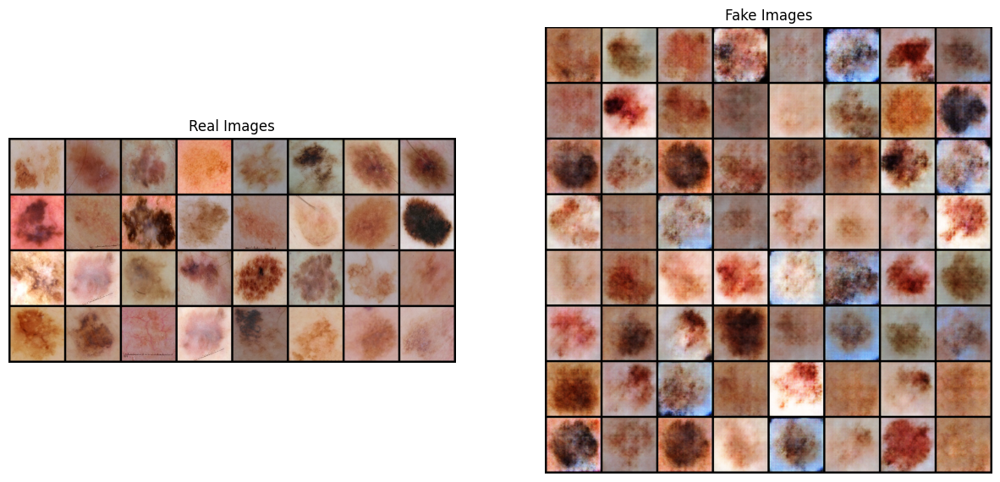

In [25]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))
OUT_DIR = Path("/content/drive/MyDrive/ISIC2017/synthetic_melanoma")
img_list = list(OUT_DIR.glob('*.png'))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(vutils.make_grid(fake[:64], padding=5, normalize=True).cpu(),(1,2,0)))
plt.show()